# Fast Sweeping & Fast Marching methods for the solution of eikonal equations

Julia implementations of solvers for general Eikonal equations of the form

$$\begin{align}
&\left\Vert\nabla \tau\right\Vert = \sigma(x,y), && \forall (x,y)\in\Omega\subset\mathbb{R}^2,\\
&\tau(x_0,y_0) = 0, && \forall (x_0,y_0)\in\Gamma\subset\Omega,
\end{align}$$

where $\Omega$ is a rectangular, 2D spatial domain, and $\tau(x,y)$ represents
the first arrival time at point $(x,y)$ of a front moving with slowness
$\sigma$ (i.e. speed $1/\sigma$) and originating from $\Gamma$.

This package provides implementations for two methods

- Fast Sweeping Method (FSM)  [1]
- Fast Marching Method (FMM)  [2]

[1] Zhao, Hongkai (2005-01-01). "A fast sweeping method for Eikonal equations". Mathematics of Computation. 74 (250): 603–627. [DOI: 10.1090/S0025-5718-04-01678-3](https://doi.org/10.1090%2FS0025-5718-04-01678-3)<br/>
[2] J.A. Sethian. A Fast Marching Level Set Method for Monotonically Advancing Fronts, Proc. Natl. Acad. Sci., 93, 4, pp.1591--1595, 1996. [PDF](https://math.berkeley.edu/~sethian/2006/Papers/sethian.fastmarching.pdf)

## Example: path planning in a maze

In this example, we solve an Eikonal equation in order to find a shortest path
in a maze described by the following picture:

![](maze.png)

We first load the package:

In [1]:
import Pkg                                         #hide
Pkg.activate(joinpath(@__DIR__, ".."), io=devnull) #hide
Pkg.resolve(io=devnull)                            #hide
using Eikonal

We then create a solver object, in this case, we'll use the Fast Sweeping
Method and build a solver of type `FastSweeping`. A convenience function is
provided to create the solver from an image, in which case the grid size is
taken from the image size, and the slowness $\sigma$ is initialized based on
the pixel colors. Here, we'll consider walls (black pixels) to be
unreacheable: they have infinite slowness. White pixels have an (arbitrary)
finite slowness.

In [2]:
solver = FastSweeping("maze.png", ["white"=>1.0, "black"=>Inf])

FastSweeping solver on a 1024×1970 grid

NB: it would also have been possible to create an uninitialized solver providing only its grid size. The slowness field could then be initialized by accessing its internal field `v`:
```julia
(m,n) = 1000, 2000
fsm = FastSweeping(m, n)  # a FastSweeping solver operating on a m×n grid
fsm.v .= rand()           # initialize its slowness field
```

We then define the grid position of the maze entrance. It is entered as a boundary condition for the solver.

In [3]:
entrance = (10, 100)
init!(solver, entrance)

FastSweeping solver on a 1024×1970 grid

The eikonal equation can now be solved using the FSM, yielding a field of
first arrival times in each grid cell.

In [4]:
@time sweep!(solver, verbose=true, epsilon=1e-5)

iter 1, sweep 1: change = Inf
iter 1, sweep 2: change = Inf
iter 1, sweep 3: change = Inf
iter 1, sweep 4: change = Inf
iter 2, sweep 1: change = Inf
iter 2, sweep 2: change = Inf
iter 2, sweep 3: change = Inf
iter 2, sweep 4: change = Inf
iter 3, sweep 1: change = Inf
iter 3, sweep 2: change = Inf
iter 3, sweep 3: change = Inf
iter 3, sweep 4: change = Inf
iter 4, sweep 1: change = Inf
iter 4, sweep 2: change = Inf
iter 4, sweep 3: change = Inf
iter 4, sweep 4: change = Inf
iter 5, sweep 1: change = 0.0004705541741910328
iter 5, sweep 2: change = 0.0004054775398044605
iter 5, sweep 3: change = 0.00039502111105829294
iter 5, sweep 4: change = 0.00040129285092875544
iter 6, sweep 1: change = 0.00037509617758043994
iter 6, sweep 2: change = 0.0003501112742417998
iter 6, sweep 3: change = 0.00039517721261634047
iter 6, sweep 4: change = 0.00032159223080942674
iter 7, sweep 1: change = 0.00028578425123230094
iter 7, sweep 2: change = 0.00019779701883849897
iter 7, sweep 3: change = 0.00024

true

First arrival times are infinite in some grid cells (since pixels inside walls
are unreacheable). We'll give them a large but finite value in order to avoid
problems when plotting. Since the arrival time at the maze goal is the largest
useful time value, we'll set the arrival times inside walls to be 10% more than that.

In [5]:
goal = size(solver.t) .- (10, 100)
tmax = solver.t[goal...]
solver.t .= min.(solver.t, 1.1*tmax);

The `ray` function can be used to find the shortest path from entrance to
goal, backtracking in the arrival times field. The ray is represented as a vector of grid coordinates:

In [6]:
r = ray(solver.t, goal)

6047-element Vector{Tuple{Int64, Int64}}:
 (1015, 1871)
 (1015, 1870)
 (1014, 1870)
 (1014, 1869)
 (1014, 1868)
 (1013, 1868)
 (1013, 1867)
 (1012, 1867)
 (1012, 1866)
 (1012, 1865)
 ⋮
 (19, 100)
 (18, 100)
 (17, 100)
 (16, 100)
 (15, 100)
 (14, 100)
 (13, 100)
 (12, 100)
 (11, 100)

Let's finally plot everything:

- arrival times are represented with color levels and contour lines;
- the shortest path from entrance to goal is represented as a thick green line.

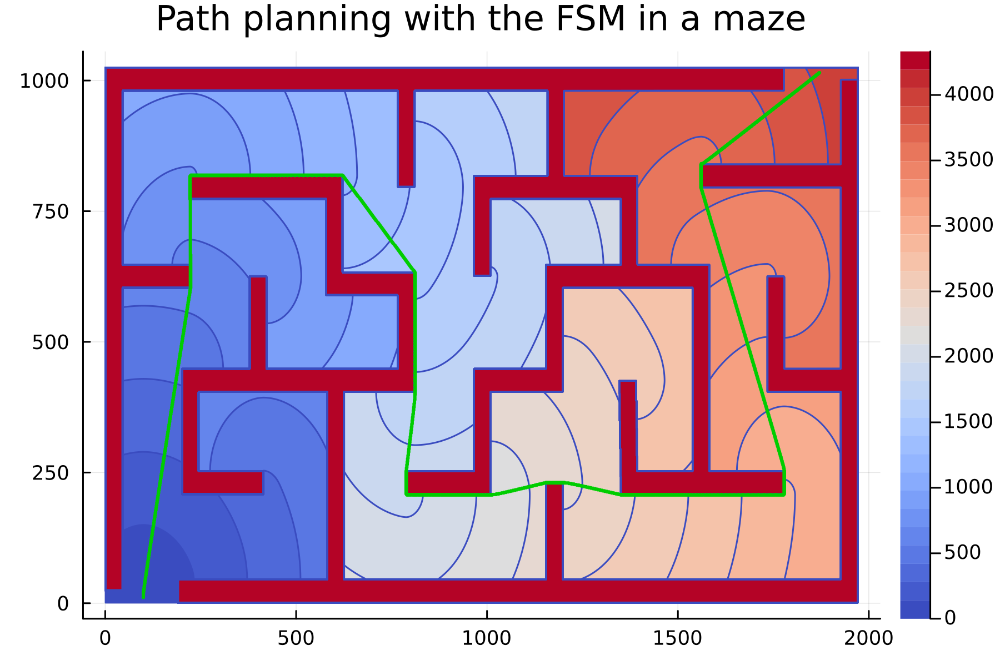

In [7]:
using Plots

plot(title="Path planning with the FSM in a maze", dpi=300)
contour!(solver.t, levels=30, fill=true, c=:coolwarm)
plot!(last.(r), first.(r),
      linewidth=2, linecolor=:green3, label=nothing)

---

*This notebook was generated using [Literate.jl](https://github.com/fredrikekre/Literate.jl).*